In [1]:
from google.colab import drive
drive.mount('/content/drive')

%cd drive/MyDrive/'Colab Notebooks'/gan-bending-master

Mounted at /content/drive
/content/drive/MyDrive/Colab Notebooks/gan-bending-master


In [2]:
# !git clone https://github.com/huggingface/community-events.git
!pip install community-events/.

Processing ./community-events
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 258.1/258.1 kB 5.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 519.6/519.6 kB 11.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 19.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.6/44.6 kB 6.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.3/88.3 kB 12.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 285.7/285.7 kB 19.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 302.0/302.0 kB 19.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.3/115.3 kB 15.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 24.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 19.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.7/98.7 kB 14.4 MB/s

In [17]:
!pip install -U huggingface-hub==0.12.0 open_clip_torch

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 9.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.1/53.1 kB 6.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 20.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 29.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 34.6 MB/s eta 0:00:00


In [ ]:
import cv2
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.optim import Adam
from torchvision.io import read_image
import torchvision.transforms as T
import kornia as K
from kornia import morphology as morph
from kornia.geometry.transform import rotate
import numpy as np
import os
from PIL import Image
import matplotlib.pyplot as plt
from matplotlib import rcParams
from collections.abc import Iterable
from huggingface_hub import hf_hub_download
from math import log2
from huggan.pytorch.huggan_mixin import HugGANModelHubMixin
from einops import rearrange
from collections import OrderedDict
from tqdm import tqdm
from typing import Any, Tuple, Union
import open_clip
from clip import TextPrompt, NCELoss

In [5]:
# Clone this model
# !git clone https://huggingface.co/huggan/fastgan-few-shot-anime-face
%cd fastgan-few-shot-anime-face/

/content/drive/MyDrive/Colab Notebooks/gan-bending-master/fastgan-few-shot-anime-face


In [30]:
import sys
sys.path.append('..')

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [31]:
import cv2
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.optim import Adam
from torchvision.io import read_image
import torchvision.transforms as T
import kornia as K
from kornia import morphology as morph
from kornia.geometry.transform import rotate
import numpy as np
import os
from PIL import Image
import matplotlib.pyplot as plt
from matplotlib import rcParams
from collections.abc import Iterable
from huggingface_hub import hf_hub_download
from math import log2
from huggan.pytorch.huggan_mixin import HugGANModelHubMixin
from einops import rearrange
from collections import OrderedDict
from tqdm import tqdm
from typing import Any, Tuple, Union
import open_clip
from clip import TextPrompt, NCELoss
from utils import (
    ImageType,
    crop_image_part,
)

from layers import (
    SpectralConv2d,
    InitLayer,
    SLEBlock,
    UpsampleBlockT1,
    UpsampleBlockT2,
    DownsampleBlockT1,
    DownsampleBlockT2,
    Decoder,
)

%load_ext autoreload
%autoreload 2

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [8]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
device

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


'cuda'

In [9]:
class Generator(nn.Module, HugGANModelHubMixin):

    def __init__(self, in_channels: int,
                       out_channels: int,
                       bending_module=None,
                       train_bending=False,):
        super().__init__()

        self.bending_module = bending_module
        self.train_bending = train_bending

        self._channels = {
                4:    1024,
                8:    512,
                16:   256,
                32:   128,
                64:   128,
                128:  64,
                256:  32,
                512:  16,
                1024: 8,
            }

        self._init = InitLayer(
                in_channels=in_channels,
                out_channels=self._channels[4],
            )

        self._upsample_8    = UpsampleBlockT2(in_channels=self._channels[4],   out_channels=self._channels[8]   )
        self._upsample_16   = UpsampleBlockT1(in_channels=self._channels[8],   out_channels=self._channels[16]  )
        self._upsample_32   = UpsampleBlockT2(in_channels=self._channels[16],  out_channels=self._channels[32]  )
        self._upsample_64   = UpsampleBlockT1(in_channels=self._channels[32],  out_channels=self._channels[64]  )
        self._upsample_128  = UpsampleBlockT2(in_channels=self._channels[64],  out_channels=self._channels[128] )
        self._upsample_256  = UpsampleBlockT1(in_channels=self._channels[128], out_channels=self._channels[256] )
        self._upsample_512  = UpsampleBlockT2(in_channels=self._channels[256], out_channels=self._channels[512] )
        self._upsample_1024 = UpsampleBlockT1(in_channels=self._channels[512], out_channels=self._channels[1024])

        self._sle_64  = SLEBlock(in_channels=self._channels[4],  out_channels=self._channels[64] )
        self._sle_128 = SLEBlock(in_channels=self._channels[8],  out_channels=self._channels[128])
        self._sle_256 = SLEBlock(in_channels=self._channels[16], out_channels=self._channels[256])
        self._sle_512 = SLEBlock(in_channels=self._channels[32], out_channels=self._channels[512])

        self._out_128 = nn.Sequential(
                SpectralConv2d(
                    in_channels=self._channels[128],
                    out_channels=out_channels,
                    kernel_size=1,
                    stride=1,
                    padding='same',
                    bias=False,
                ),
                nn.Tanh(),
            )

        self._out_1024 = nn.Sequential(
                SpectralConv2d(
                    in_channels=self._channels[1024],
                    out_channels=out_channels,
                    kernel_size=3,
                    stride=1,
                    padding='same',
                    bias=False,
                ),
                nn.Tanh(),
            )

    def forward(self, input: torch.Tensor, bend=True, return_bendin=False) -> \
            Tuple[torch.Tensor, torch.Tensor]:
        size_4  = self._init(input)
        size_8  = self._upsample_8(size_4)
        size_16 = self._upsample_16(size_8)
        size_32 = self._upsample_32(size_16)

        size_64  = self._sle_64 (size_4,  self._upsample_64 (size_32) )
        size_128 = self._sle_128(size_8,  self._upsample_128(size_64) )

        # if bend and self.bending_module is not None:
        #   bend_in = size_128
        #   size_128 = self.bending_module(size_128)

        size_256 = self._sle_256(size_16, self._upsample_256(size_128))

        # if bend and self.bending_module is not None:
        #   bend_in = size_256
        #   size_256 = self.bending_module(size_256)

        size_512 = self._sle_512(size_32, self._upsample_512(size_256))

        if bend and self.bending_module is not None:
          bend_in = size_512
          size_512 = self.bending_module(size_512)

        size_1024 = self._upsample_1024(size_512)

        # if bend and self.bending_module is not None:
        #   bend_in = size_1024
        #   size_1024 = self.bending_module(size_1024)

        out_128  = self._out_128 (size_128)
        out_1024 = self._out_1024(size_1024)
        if return_bendin: return out_1024, bend_in
        return out_1024, out_128

    @classmethod
    def from_pretrained(cls,
                        model_id,
                        in_channels=256,
                        out_channels=3,
                        bending_module=None,
                        train_bending=False,
                        map_location="cpu"):
        '''overrides method from ModelHubMixin'''

        model_file = hf_hub_download(
            repo_id=str(model_id),
            filename='pytorch_model.bin',
            revision=None,
            cache_dir=None,
            force_download=False,
            proxies=None,
            resume_download=False,
            token=None,
            local_files_only=False
        )

        state_dict = torch.load(model_file,
                                map_location=map_location)
        print(state_dict.keys())

        model = cls(in_channels=in_channels,
                    out_channels=out_channels,
                    bending_module=bending_module,
                    train_bending=train_bending)
        model.load_state_dict(state_dict, strict=False)
        model.eval()

        for param in model.parameters():
            param.requires_grad = False
        if train_bending==True and bending_module is not None:
            for param in model.bending_module.parameters():
                param.requires_grad = True

        return model

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [10]:
class BendingModule(nn.Module):
    def __init__(self, n_channels):
        super(BendingModule, self).__init__()
        self.in_channels = self.out_channels = n_channels
        self.hid_channels = n_channels
        self.w1 = nn.Conv2d(self.in_channels,
                            self.hid_channels, 3,
                            padding='same')
        self.w2 = nn.Conv2d(self.hid_channels,
                            self.out_channels, 3,
                            padding='same')

    def forward(self, x):
        x = self.w1(x)
        x = F.relu(x)
        return self.w2(x)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [11]:
numchans = {'_sle_256': 32, '_sle_512': 16, '_sle_128': 64,'_upsample_1024': 8}

n_channels = numchans['_sle_512']
bendingmod = BendingModule(n_channels)
torch.cuda.empty_cache()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [14]:
def _denormalize(input: torch.Tensor) -> torch.Tensor:
    return (input * 127.5) + 127.5

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [15]:
def generate_image(model, bend=True):
  model = model.to('cpu')
  with torch.no_grad():
        ims, _ = model(torch.randn(1, 256, 1, 1), bend=bend)
        ims = _denormalize(ims.detach()).permute(0,2,3,1).cpu().numpy().astype(np.uint8)
  return Image.fromarray(ims[0])

def image_grid(imgs, rows, cols):
  assert len(imgs) == rows*cols

  w, h = imgs[0].size
  grid = Image.new('RGB', size=(cols*w, rows*h))
  grid_w, grid_h = grid.size

  for i, img in enumerate(imgs):
      grid.paste(img, box=(i%cols*w, i//cols*h))
  return grid

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


odict_keys(['_init._layers.0._conv.weight_orig', '_init._layers.0._conv.weight_u', '_init._layers.0._conv.weight_v', '_init._layers.1.weight', '_init._layers.1.bias', '_init._layers.1.running_mean', '_init._layers.1.running_var', '_init._layers.1.num_batches_tracked', '_upsample_8._layers.1._conv.weight_orig', '_upsample_8._layers.1._conv.weight_u', '_upsample_8._layers.1._conv.weight_v', '_upsample_8._layers.2._weight', '_upsample_8._layers.3.weight', '_upsample_8._layers.3.bias', '_upsample_8._layers.3.running_mean', '_upsample_8._layers.3.running_var', '_upsample_8._layers.3.num_batches_tracked', '_upsample_8._layers.5._conv.weight_orig', '_upsample_8._layers.5._conv.weight_u', '_upsample_8._layers.5._conv.weight_v', '_upsample_8._layers.6._weight', '_upsample_8._layers.7.weight', '_upsample_8._layers.7.bias', '_upsample_8._layers.7.running_mean', '_upsample_8._layers.7.running_var', '_upsample_8._layers.7.num_batches_tracked', '_upsample_16._layers.1._conv.weight_orig', '_upsample_

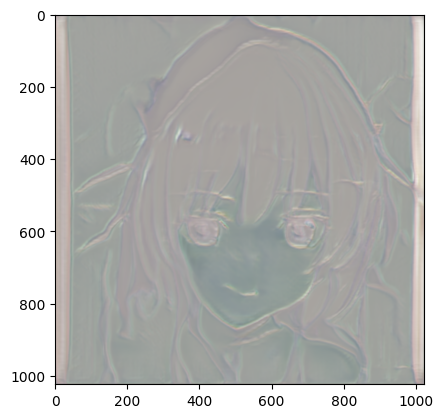

In [16]:
# Generate a random noise image
generator = Generator.from_pretrained("huggan/fastgan-few-shot-anime-face", in_channels=256, out_channels=3, bending_module=bendingmod, train_bending=True).to(device)
noise = torch.randn(1, 256, 1, 1, device=device)
with torch.no_grad():
  gan_images, _ = generator(noise, bend=True)

gan_images = _denormalize(gan_images.detach()).permute(0,2,3,1).cpu().numpy().astype(np.uint8)
plt.imshow(gan_images[0])

CLIP loss

In [19]:
# Load CLIP model:
clip_model, _, preprocess = open_clip.create_model_and_transforms(
    'ViT-B-32-quickgelu', pretrained='laion400m_e32'
)
clip_model.to(device)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
100%|███████████████████████████████████████| 605M/605M [00:08<00:00, 75.0MiB/s]


CLIP(
  (visual): VisionTransformer(
    (patchnorm_pre_ln): Identity()
    (conv1): Conv2d(3, 768, kernel_size=(32, 32), stride=(32, 32), bias=False)
    (patch_dropout): Identity()
    (ln_pre): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
    (transformer): Transformer(
      (resblocks): ModuleList(
        (0-11): 12 x ResidualAttentionBlock(
          (ln_1): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
          (attn): MultiheadAttention(
            (out_proj): NonDynamicallyQuantizableLinear(in_features=768, out_features=768, bias=True)
          )
          (ls_1): Identity()
          (ln_2): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
          (mlp): Sequential(
            (c_fc): Linear(in_features=768, out_features=3072, bias=True)
            (gelu): QuickGELU()
            (c_proj): Linear(in_features=3072, out_features=768, bias=True)
          )
          (ls_2): Identity()
        )
      )
    )
    (ln_post): LayerNorm((768,), eps=1e-

In [20]:
# Create transforms to feed images to CLIP:
clip_tfms = T.Compose(preprocess.transforms[:2]+preprocess.transforms[-1:])

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [35]:
class TextPrompt(nn.Module):
    def __init__(self, prompt_text):
        super(TextPrompt, self).__init__()
        self.prompt_text = prompt_text
        with torch.no_grad():
            tokenized_text = open_clip.tokenize([prompt_text]).to(device)
            self.prompt_embed = clip_model.encode_text(tokenized_text)

        # As a bonus, we can do some augmentation
        self.aug_tfms = T.Compose([
            T.RandomResizedCrop(480),
            T.RandomAffine(5),
            T.ColorJitter(),
            T.GaussianBlur(5)
        ])

    def forward(self, x, augment=True, return_mean=True):
        """
        Take a batch of images (x), encode them with clip_model
        and score each with the prompt using Squared Great Circle Distance
        (Lower is better).
        """
        if augment:
            x = self.aug_tfms(x)
        image_embeds = clip_model.encode_image(clip_tfms(x))
        input_normed = F.normalize(image_embeds.unsqueeze(1), dim=2)
        embed_normed = F.normalize(self.prompt_embed.unsqueeze(0), dim=2)
        dists = input_normed.sub(embed_normed).norm(dim=2).div(2).arcsin().pow(2).mul(2)
        if return_mean:
            return dists.mean()
        return dists

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [36]:
# Create new bending module to optimize
# with CLIP loss
bendingmod_clip = BendingModule(n_channels)

bend_generator_clip = Generator.from_pretrained("huggan/fastgan-few-shot-anime-face", in_channels=256, out_channels=3, bending_module=bendingmod_clip, train_bending=True)
bend_generator_clip = bend_generator_clip.to(device)

tgt_text = 'large fire burning'
text_prompt = TextPrompt(tgt_text)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


odict_keys(['_init._layers.0._conv.weight_orig', '_init._layers.0._conv.weight_u', '_init._layers.0._conv.weight_v', '_init._layers.1.weight', '_init._layers.1.bias', '_init._layers.1.running_mean', '_init._layers.1.running_var', '_init._layers.1.num_batches_tracked', '_upsample_8._layers.1._conv.weight_orig', '_upsample_8._layers.1._conv.weight_u', '_upsample_8._layers.1._conv.weight_v', '_upsample_8._layers.2._weight', '_upsample_8._layers.3.weight', '_upsample_8._layers.3.bias', '_upsample_8._layers.3.running_mean', '_upsample_8._layers.3.running_var', '_upsample_8._layers.3.num_batches_tracked', '_upsample_8._layers.5._conv.weight_orig', '_upsample_8._layers.5._conv.weight_u', '_upsample_8._layers.5._conv.weight_v', '_upsample_8._layers.6._weight', '_upsample_8._layers.7.weight', '_upsample_8._layers.7.bias', '_upsample_8._layers.7.running_mean', '_upsample_8._layers.7.running_var', '_upsample_8._layers.7.num_batches_tracked', '_upsample_16._layers.1._conv.weight_orig', '_upsample_

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
100%|██████████| 1000/1000 [09:35<00:00,  1.74it/s]


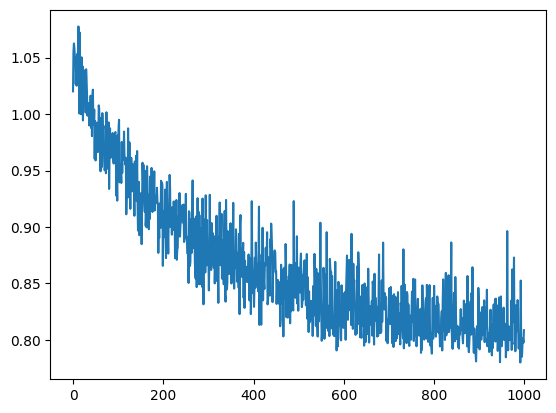

In [37]:
torch.cuda.empty_cache()

batch_size = 16

n_iter = 1000

opt = Adam(bendingmod_clip.parameters(), 1e-4)

loss_log = []

for i in tqdm(range(n_iter)):

    out, _ = bend_generator_clip(torch.randn(batch_size, 256, 1, 1, device=device))

    loss = text_prompt(out)
    loss_log.append(loss.detach().cpu().numpy())

    with torch.no_grad():
      loss.backward()
      opt.step()
      opt.zero_grad()


plt.plot(range(n_iter), loss_log)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


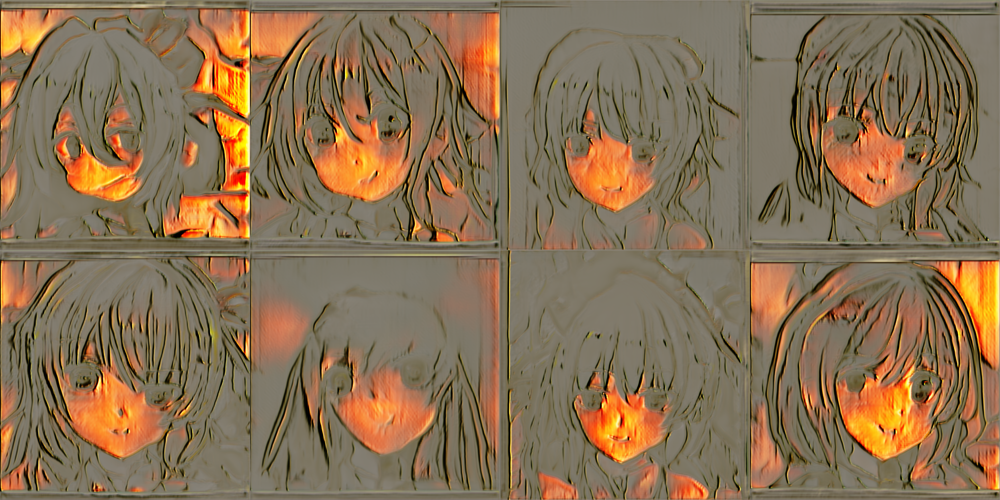

In [38]:
exampleimgs = [generate_image(bend_generator_clip) for _ in range(8)]
image_grid(exampleimgs, 2, 4)

Diversity Loss

In [39]:
torch.cuda.empty_cache()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [40]:
def compute_diversity_loss(output_batch, noise_batch):

    assert output_batch.shape[0] == noise_batch.shape[0] and \
        output_batch.shape[0] % 2 == 0

    batch_size = output_batch.shape[0]

    outputs1 = output_batch[np.arange(0, batch_size, 2), ...].reshape(
            batch_size//2, -1)
    outputs2 = output_batch[np.arange(1, batch_size, 2), ...].reshape(
            batch_size//2, -1)
    noises1 = noise_batch[np.arange(0, batch_size, 2), ...].reshape(
            batch_size//2, -1)
    noises2 = noise_batch[np.arange(1, batch_size, 2), ...].reshape(
            batch_size//2, -1)

    noisesdiff = F.normalize(torch.mean(torch.abs(noises2 - noises1), axis=1), dim=0)
    outputsdiff = F.normalize(torch.mean(torch.abs(outputs2 - outputs1), axis=1), dim=0)

    # mode seeking loss
    loss_lz = torch.mean(noisesdiff/outputsdiff)

    return loss_lz

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [41]:
# Create new bending module to optimize
# with CLIP loss
bendmod_clip_div = BendingModule(n_channels)

bend_gen_clip_div = Generator.from_pretrained("huggan/fastgan-few-shot-anime-face", in_channels=256, out_channels=3, bending_module=bendmod_clip_div, train_bending=True)
bend_gen_clip_div = bend_gen_clip_div.to(device)

tgt_text = 'Tiffany lamp of la Guernica'
text_prompt = TextPrompt(tgt_text)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


odict_keys(['_init._layers.0._conv.weight_orig', '_init._layers.0._conv.weight_u', '_init._layers.0._conv.weight_v', '_init._layers.1.weight', '_init._layers.1.bias', '_init._layers.1.running_mean', '_init._layers.1.running_var', '_init._layers.1.num_batches_tracked', '_upsample_8._layers.1._conv.weight_orig', '_upsample_8._layers.1._conv.weight_u', '_upsample_8._layers.1._conv.weight_v', '_upsample_8._layers.2._weight', '_upsample_8._layers.3.weight', '_upsample_8._layers.3.bias', '_upsample_8._layers.3.running_mean', '_upsample_8._layers.3.running_var', '_upsample_8._layers.3.num_batches_tracked', '_upsample_8._layers.5._conv.weight_orig', '_upsample_8._layers.5._conv.weight_u', '_upsample_8._layers.5._conv.weight_v', '_upsample_8._layers.6._weight', '_upsample_8._layers.7.weight', '_upsample_8._layers.7.bias', '_upsample_8._layers.7.running_mean', '_upsample_8._layers.7.running_var', '_upsample_8._layers.7.num_batches_tracked', '_upsample_16._layers.1._conv.weight_orig', '_upsample_

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
100%|██████████| 1000/1000 [10:01<00:00,  1.66it/s]


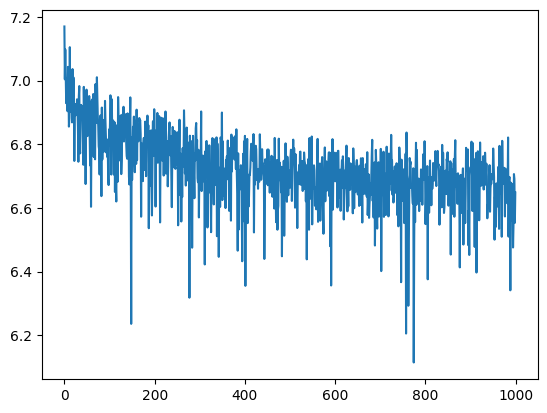

In [42]:
torch.cuda.empty_cache()

batch_size = 16

n_iter = 1000

lz_weight = 6. #3.

opt = Adam(bendmod_clip_div.parameters(), 1e-3)

loss_log = []

for i in tqdm(range(n_iter)):

    noise_input = torch.randn(batch_size, 256, 1, 1, device=device)

    out, b_in = bend_gen_clip_div(noise_input, return_bendin=True)

    loss = text_prompt(out) + \
        lz_weight * compute_diversity_loss(out, b_in)
    loss_log.append(loss.detach().cpu().numpy())

    with torch.no_grad():
        loss.backward()
        opt.step()
        opt.zero_grad()

plt.plot(range(n_iter), loss_log)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


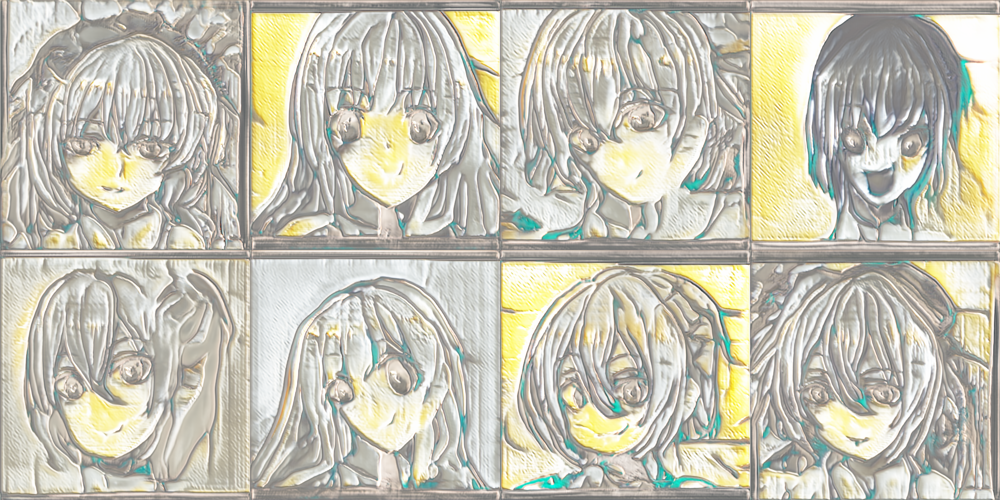

In [43]:
exampleimgs = [generate_image(bend_gen_clip_div) for _ in range(8)]
image_grid(exampleimgs, 2, 4)